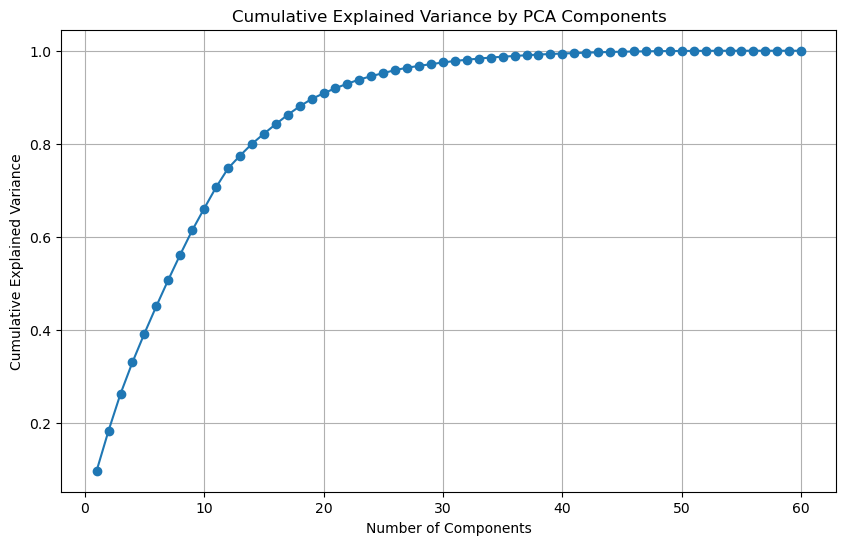

Selected 25 components to retain at least 95% of the variance.
K-means Davies-Bouldin Index: 2.31
Hierarchical Davies-Bouldin Index: 2.67
DBSCAN did not find any clusters (only noise).
 [ 100 / 100 ] 100% - 0:00:00 left 
 quantization error: 1.3126812375459094
Fuzzy C-Means Davies-Bouldin Index: 3.14
Number of PCA features selected: 25
Reduced data shape: (3964, 25)


In [ ]:


import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.preprocessing import MinMaxScaler  # Use MinMaxScaler for normalization
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import davies_bouldin_score
from minisom import MiniSom  # Import SOM
from mpl_toolkits.mplot3d import Axes3D
import skfuzzy as fuzz

# Load the dataset
df = pd.read_csv(os.path.join('..', '..', 'data', 'social-media', 'OnlineNewsPopularity.csv'))

# Preprocessing: Handle missing values
df = df.dropna()

# Sample a subset of the data to reduce memory usage
df = df.sample(frac=0.1, random_state=42)  # Adjust the fraction as needed

# Select relevant numerical columns for clustering
numeric_cols = df.select_dtypes(include=['number']).columns.tolist()

# Step 2: Normalize the features
scaler = MinMaxScaler()
df_normalized = scaler.fit_transform(df[numeric_cols])

# Step 3: Dimensionality Reduction (show cumulative variance before selecting components)
pca = PCA()
pca_fit = pca.fit(df_normalized)
explained_variance = np.cumsum(pca_fit.explained_variance_ratio_)

# Plot cumulative variance explained by PCA components
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid()
plt.show()

# Select enough components to retain at least 95% variance
n_components = np.argmax(explained_variance >= 0.95) + 1  # Add 1 because of 0-based indexing
pca = PCA(n_components=n_components)
pca_fit = pca.fit(df_normalized)
reduced_data = pca.transform(df_normalized)

print(f'Selected {n_components} components to retain at least 95% of the variance.')

# **Algorithm 1: K-means Clustering**
kmeans = KMeans(n_clusters=4, random_state=42)
df['kmeans_cluster'] = kmeans.fit_predict(reduced_data[:, :25])  # Use the first 3 PCA components for 3D plot

# Evaluate K-means clustering using Davies-Bouldin Index
kmeans_davies_bouldin = davies_bouldin_score(reduced_data[:, :25], df['kmeans_cluster'])
print(f'K-means Davies-Bouldin Index: {kmeans_davies_bouldin:.2f}')

# **Algorithm 6: Fuzzy C-Means Clustering**
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(reduced_data.T, c=5, m=2, error=1e-5, maxiter=1000, init=None)

# Assign cluster labels to the DataFrame
df['fuzzy_cmeans_cluster'] = np.argmax(u, axis=0)

# Evaluate Fuzzy C-Means clustering using Davies-Bouldin Index
if len(set(df['fuzzy_cmeans_cluster'])) > 1:
    fuzzy_cmeans_davies_bouldin = davies_bouldin_score(reduced_data[:, :25], df['fuzzy_cmeans_cluster'])
    print(f'Fuzzy C-Means Davies-Bouldin Index: {fuzzy_cmeans_davies_bouldin:.2f}')
else:
    print('Fuzzy C-Means did not find any clusters (only noise).')

print(f'Number of PCA features selected: {n_components}')
print(f'Reduced data shape: {reduced_data.shape}')

In [8]:
# Get the loadings of the original features on each principal component
pca_loadings = pd.DataFrame(pca.components_, columns=numeric_cols)

# Display the features that contribute most to each PCA component
# For each component, sort the features by the magnitude of the loading
for i in range(pca_loadings.shape[0]):
    print(f"Top features for PCA Component {i+1}:")
    top_features = pca_loadings.iloc[i].abs().sort_values(ascending=False).head(5)  # Top 5 features
    print(top_features)
    print('-' * 50)


Top features for PCA Component 1:
data_channel_is_world    0.636962
LDA_02                   0.461929
data_channel_is_tech     0.269728
timedelta                0.223045
LDA_04                   0.207215
Name: 0, dtype: float64
--------------------------------------------------
Top features for PCA Component 2:
data_channel_is_tech              0.515269
LDA_04                            0.435535
 data_channel_is_entertainment    0.423721
LDA_03                            0.323483
data_channel_is_world             0.195372
Name: 1, dtype: float64
--------------------------------------------------
Top features for PCA Component 3:
data_channel_is_bus               0.573972
LDA_00                            0.448379
data_channel_is_tech              0.302876
 data_channel_is_entertainment    0.251728
LDA_04                            0.205157
Name: 2, dtype: float64
--------------------------------------------------
Top features for PCA Component 4:
kw_min_min             0.515128
kw_max_

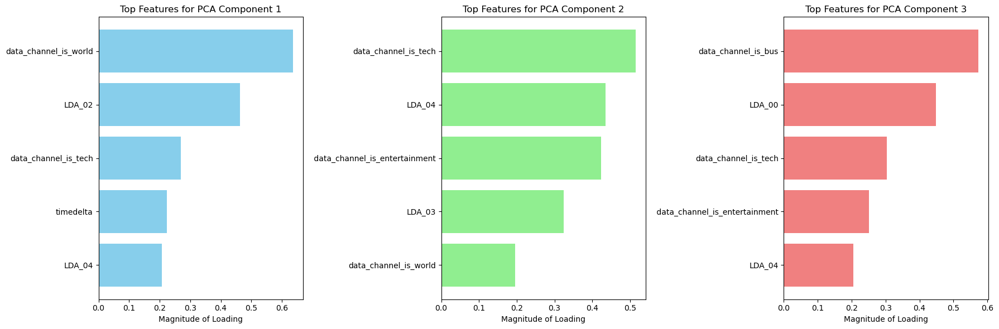

In [9]:
import matplotlib.pyplot as plt

# Get the loadings of the original features on each principal component
pca_loadings = pd.DataFrame(pca.components_, columns=numeric_cols)

# Prepare the top 5 features for each of the first 3 PCA components
top_features_1 = pca_loadings.iloc[0].abs().sort_values(ascending=False).head(5)
top_features_2 = pca_loadings.iloc[1].abs().sort_values(ascending=False).head(5)
top_features_3 = pca_loadings.iloc[2].abs().sort_values(ascending=False).head(5)

# Create a figure with 3 subplots (one for each PCA component)
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot the top features for each PCA component
axes[0].barh(top_features_1.index, top_features_1.values, color='skyblue')
axes[0].set_title('Top Features for PCA Component 1')
axes[0].set_xlabel('Magnitude of Loading')
axes[0].invert_yaxis()  # Invert y-axis to show highest values at the top

axes[1].barh(top_features_2.index, top_features_2.values, color='lightgreen')
axes[1].set_title('Top Features for PCA Component 2')
axes[1].set_xlabel('Magnitude of Loading')
axes[1].invert_yaxis()

axes[2].barh(top_features_3.index, top_features_3.values, color='lightcoral')
axes[2].set_title('Top Features for PCA Component 3')
axes[2].set_xlabel('Magnitude of Loading')
axes[2].invert_yaxis()

# Adjust layout to prevent overlapping titles and labels
plt.tight_layout()
plt.show()

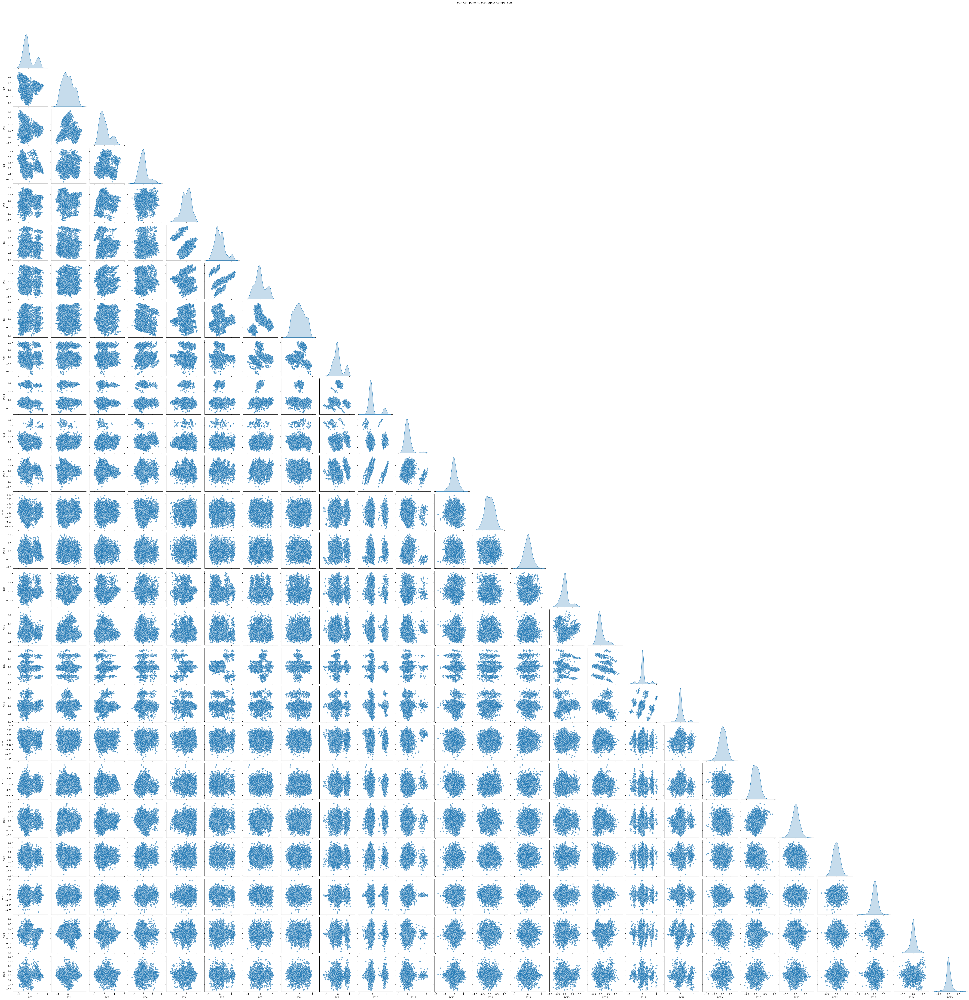

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming `reduced_data` contains the PCA-transformed data
# Convert the NumPy array to a DataFrame with appropriate column names
pca_columns = [f'PC{i+1}' for i in range(reduced_data.shape[1])]
reduced_data_df = pd.DataFrame(reduced_data, columns=pca_columns)

# Pairplot to compare all PCA components
sns.pairplot(reduced_data_df, diag_kind="kde", corner=True, plot_kws={'alpha': 0.7})
plt.suptitle('PCA Components Scatterplot Comparison', y=1.02)
plt.show()

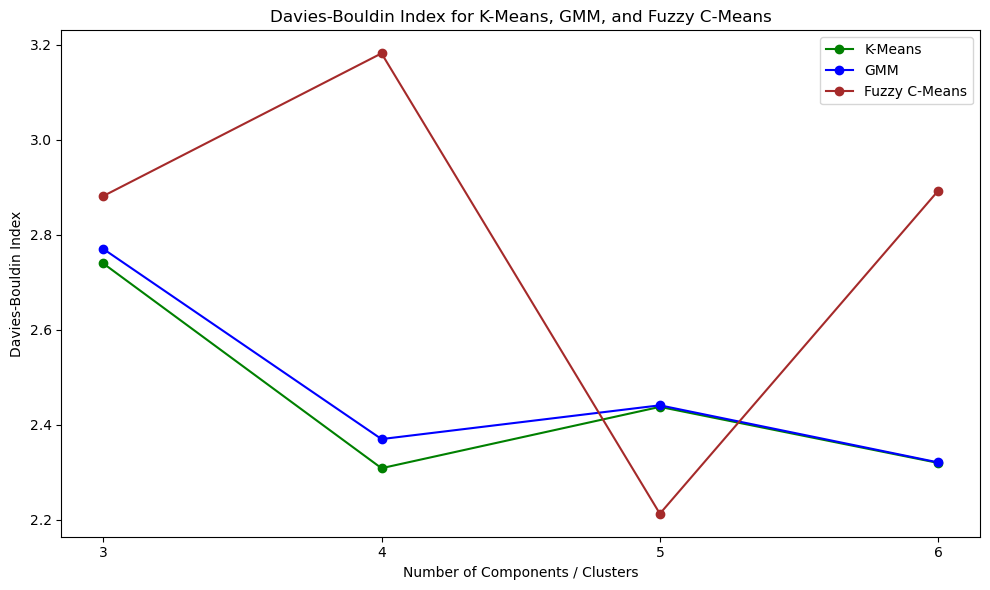

In [59]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from fuzzycmeans import FCM
from sklearn.metrics import davies_bouldin_score

# Define the number of components or clusters to test
n_components_list = [3, 4, 5, 6]

# Initialize lists to store DBI scores for each algorithm
dbi_scores_kmeans = []
dbi_scores_gmm = []
dbi_scores_fuzzy = []

# Loop over the different values of n_components
for n_components in n_components_list:
    # **K-Means Clustering**
    kmeans = KMeans(n_clusters=n_components, random_state=42)
    kmeans_cluster = kmeans.fit_predict(reduced_data[:, :25])  # Use the first 3 PCA components
    dbi_kmeans = davies_bouldin_score(reduced_data[:, :25], kmeans_cluster)
    dbi_scores_kmeans.append(dbi_kmeans)

    # **Gaussian Mixture Model (GMM)**
    gmm = GaussianMixture(n_components=n_components, random_state=42)
    gmm_cluster = gmm.fit_predict(reduced_data[:, :25])  # Use the first 3 PCA components
    dbi_gmm = davies_bouldin_score(reduced_data[:, :25], gmm_cluster)
    dbi_scores_gmm.append(dbi_gmm)

    # **Fuzzy C-Means Clustering**
    fcm = FCM(n_clusters=n_components)
    fcm.fit(reduced_data[:, :25])
    # Assign each data point to the cluster with the maximum membership value
    fuzzy_cluster = np.argmax(fcm.u, axis=1)
    dbi_fuzzy = davies_bouldin_score(reduced_data[:, :25], fuzzy_cluster)
    dbi_scores_fuzzy.append(dbi_fuzzy)

# Plotting the Davies-Bouldin Index for K-Means, GMM, and Fuzzy C-Means
plt.figure(figsize=(10, 6))

# Plotting DBI for the three algorithms
plt.plot(n_components_list, dbi_scores_kmeans, label='K-Means', marker='o', linestyle='-', color='green')
plt.plot(n_components_list, dbi_scores_gmm, label='GMM', marker='o', linestyle='-', color='blue')
plt.plot(n_components_list, dbi_scores_fuzzy, label='Fuzzy C-Means', marker='o', linestyle='-', color='brown')

# Customize plot
plt.xlabel('Number of Components / Clusters')
plt.ylabel('Davies-Bouldin Index')
plt.title('Davies-Bouldin Index for K-Means, GMM, and Fuzzy C-Means')
plt.xticks(n_components_list)
plt.legend()
plt.tight_layout()
plt.show()


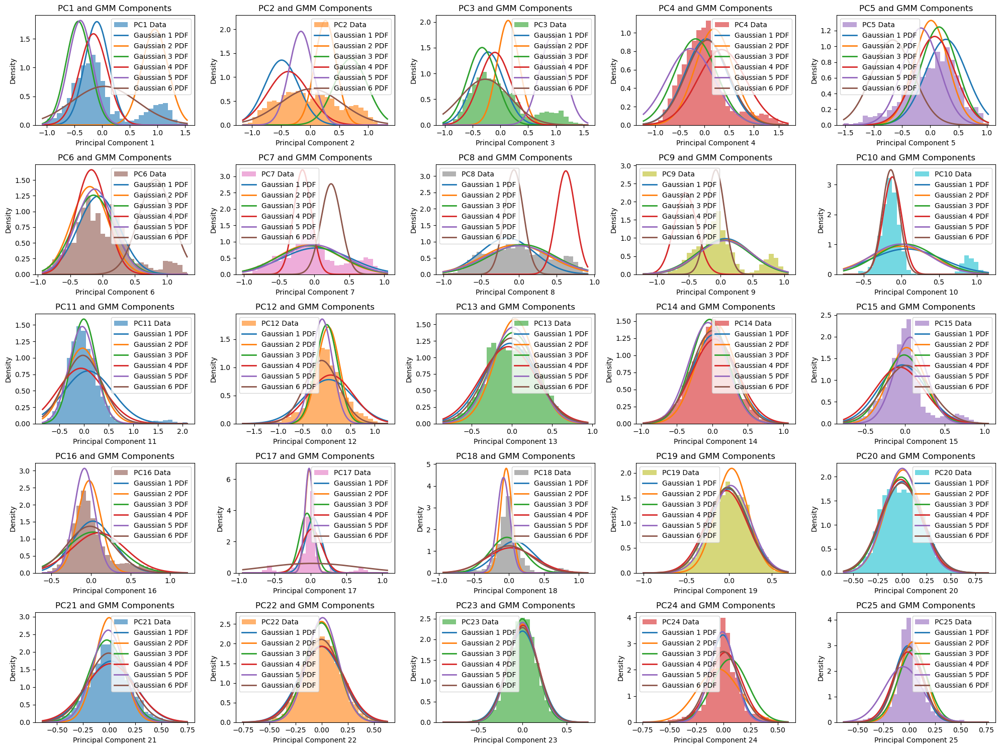

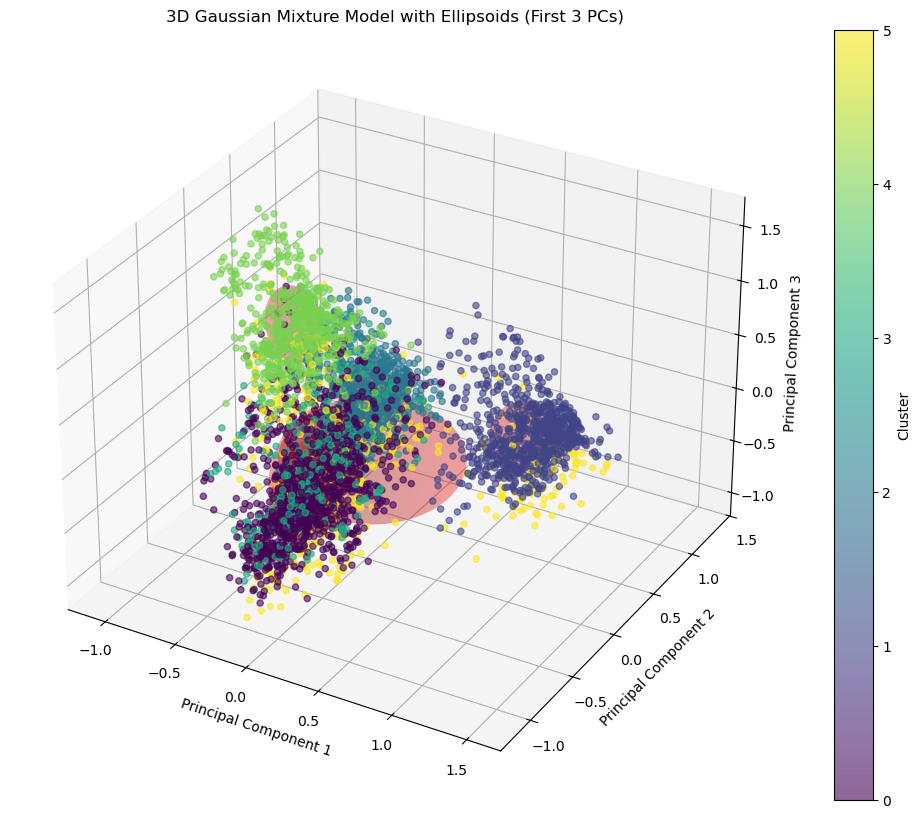

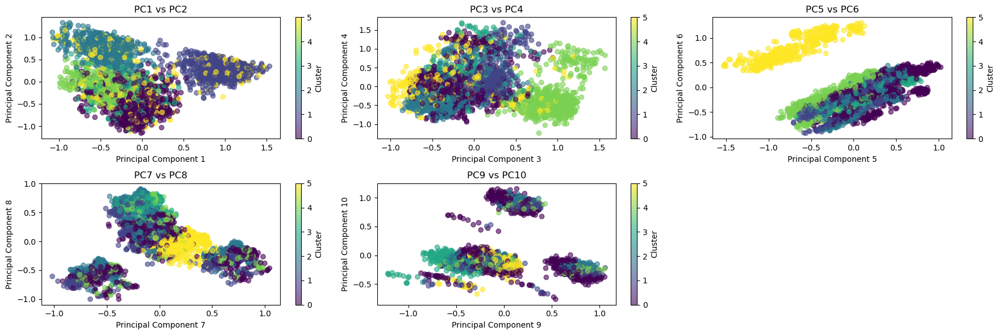

In [71]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.mixture import GaussianMixture
from scipy.stats import norm
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import multivariate_normal

# Assuming 'reduced_data' is your PCA-transformed data with 25 components
# 'gmm' is your fitted GaussianMixture model
# 'df' is your DataFrame

# Create cluster assignments using the GMM model
df['gmm_cluster'] = gmm.predict(reduced_data)

# 1. Evaluate GMM clustering using Davies-Bouldin Index
gmm_davies_bouldin = davies_bouldin_score(reduced_data, df['gmm_cluster'])

# 2. Plotting the distribution of the first 25 principal components with GMM components
plt.figure(figsize=(20, 15))
n_rows, n_cols = 5, 5  # We will create a grid of 5x5 subplots

for i in range(25):
    ax = plt.subplot(n_rows, n_cols, i + 1)
    
    # Plot histogram of the i-th principal component data
    ax.hist(reduced_data[:, i], bins=30, density=True, alpha=0.6, label=f'PC{i+1} Data', color=f'C{i%10}')
    
    # Plot Gaussian components (PDFs) for the i-th principal component
    x = np.linspace(reduced_data[:, i].min(), reduced_data[:, i].max(), 1000)
    for j in range(gmm.n_components):
        mean = gmm.means_[j, i]  # Mean for the i-th principal component
        covar = gmm.covariances_[j, i, i]  # Covariance for the i-th component
        pdf = norm.pdf(x, mean, np.sqrt(covar))
        ax.plot(x, pdf, label=f'Gaussian {j+1} PDF', lw=2)
    
    # Title and labels
    ax.set_title(f'PC{i+1} and GMM Components')
    ax.set_xlabel(f'Principal Component {i+1}')
    ax.set_ylabel('Density')
    ax.legend()

plt.tight_layout()
plt.show()


# Create a 3D plot
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot of data points
sc = ax.scatter(reduced_data[:, 0], reduced_data[:, 1], reduced_data[:, 2], c=df['gmm_cluster'], cmap='viridis', alpha=0.6)

# Plot ellipsoids for each cluster
for i in range(gmm.n_components):
    mean_3d = gmm.means_[i][:3]  # Use the first 3 dimensions of the mean
    cov_3d = gmm.covariances_[i][:3, :3]  # Extract the 3x3 covariance matrix
    plot_ellipsoid(ax, mean_3d, cov_3d, color='red', alpha=0.2)

# Add labels and legend
ax.set_title('3D Gaussian Mixture Model with Ellipsoids (First 3 PCs)')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.colorbar(sc, ax=ax, label='Cluster')
plt.show()

# 5. 2D GMM Clustering Projections
# We will show a few important pairings of principal components in 2D
plt.figure(figsize=(18, 6))

# Randomly plot some 2D pairs of principal components
pairs_to_plot = [(0, 1), (2, 3), (4, 5), (6, 7), (8, 9)]
for idx, (pc1, pc2) in enumerate(pairs_to_plot):
    ax = plt.subplot(2, 3, idx + 1)
    sc = ax.scatter(reduced_data[:, pc1], reduced_data[:, pc2], c=df['gmm_cluster'], cmap='viridis', alpha=0.6)
    ax.set_title(f'PC{pc1+1} vs PC{pc2+1}')
    ax.set_xlabel(f'Principal Component {pc1+1}')
    ax.set_ylabel(f'Principal Component {pc2+1}')
    plt.colorbar(sc, ax=ax, label='Cluster')

plt.tight_layout()
plt.show()

# 6. Optional: Visualizing GMM Cluster Distributions in 2D for All PCs
# (for a dense overview, this may need a separate implementation for visualization)


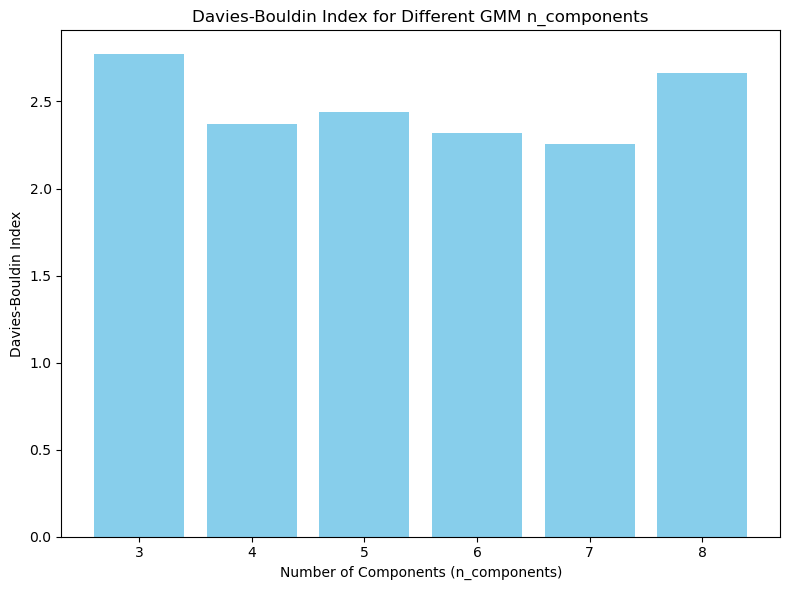

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.metrics import davies_bouldin_score

# Define the number of components to test
n_components_list = [3, 4, 5, 6,7,8]
dbi_scores = []

# Loop over the different values of n_components
for n_components in n_components_list:
    # Fit the GMM model with the current n_components
    gmm = GaussianMixture(n_components=n_components, random_state=42)
    gmm_cluster = gmm.fit_predict(reduced_data)  # Use the reduced data with all components
    
    # Calculate the Davies-Bouldin Index for the current clustering
    dbi = davies_bouldin_score(reduced_data, gmm_cluster)
    dbi_scores.append(dbi)

# Plotting the Davies-Bouldin Index for different n_components
plt.figure(figsize=(8, 6))
plt.bar(n_components_list, dbi_scores, color='skyblue')
plt.xlabel('Number of Components (n_components)')
plt.ylabel('Davies-Bouldin Index')
plt.title('Davies-Bouldin Index for Different GMM n_components')
plt.xticks(n_components_list)
plt.tight_layout()
plt.show()


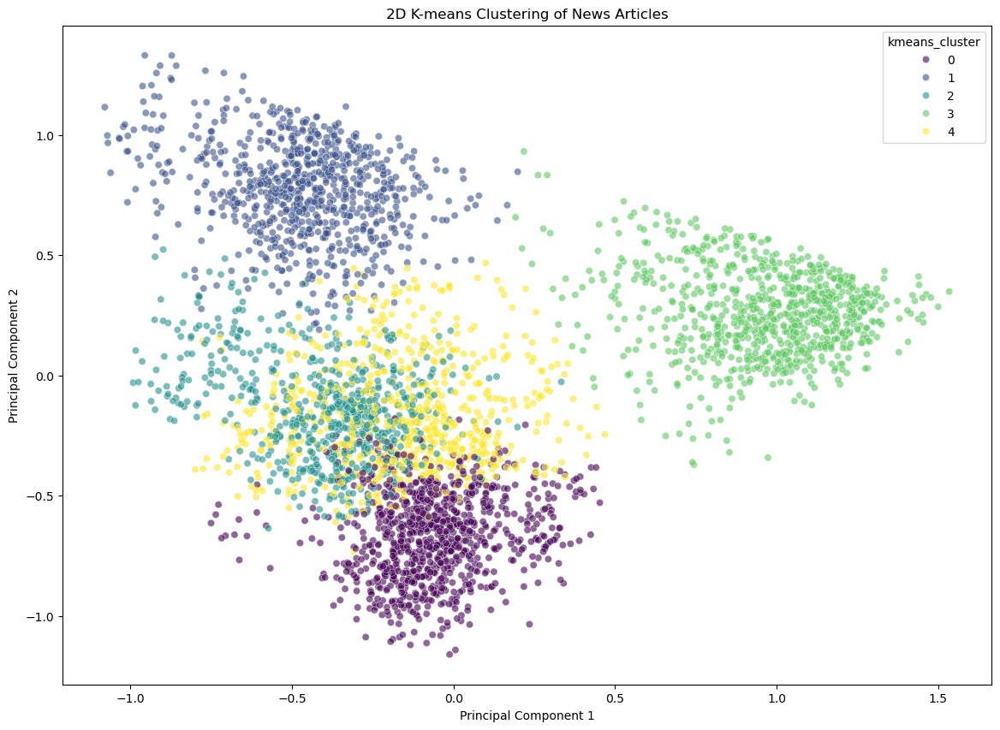

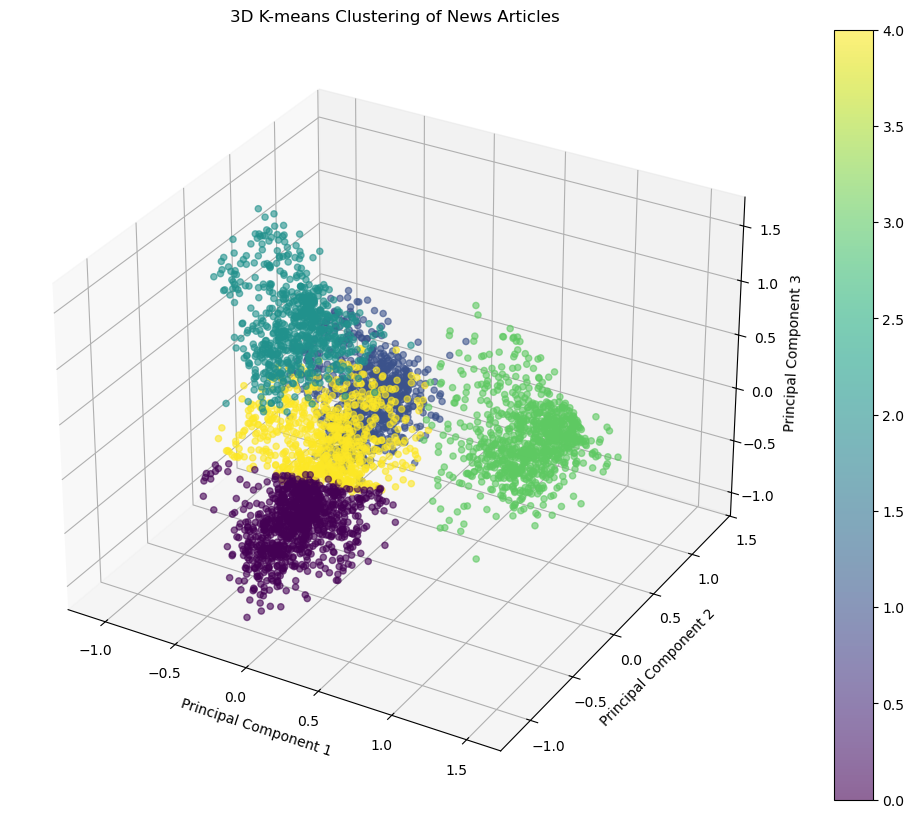

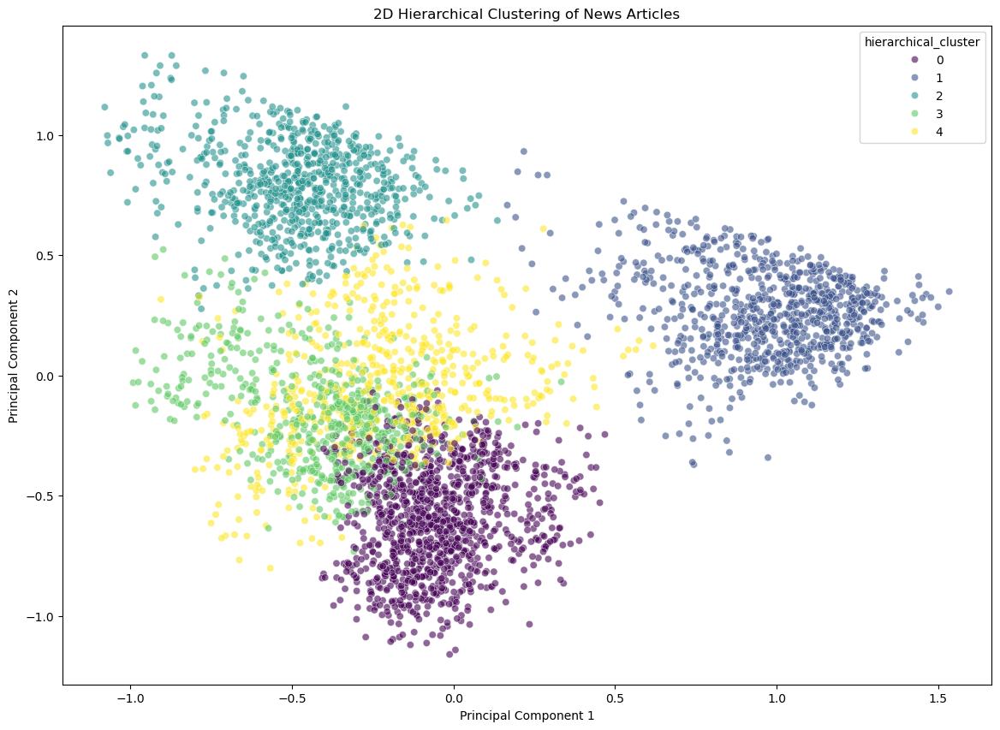

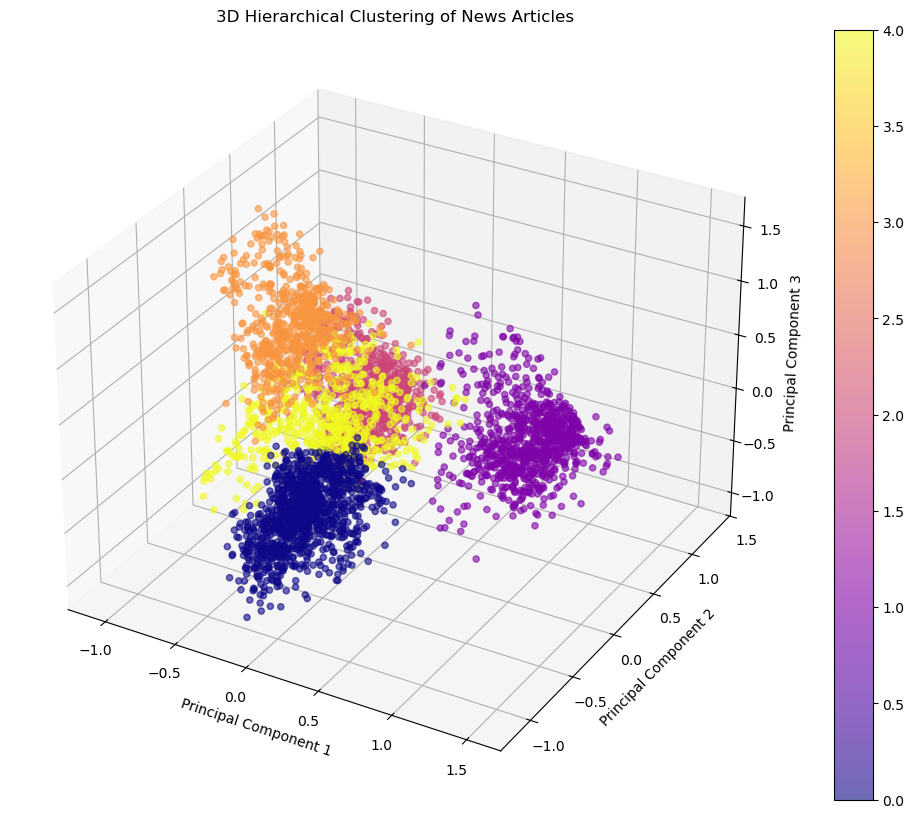

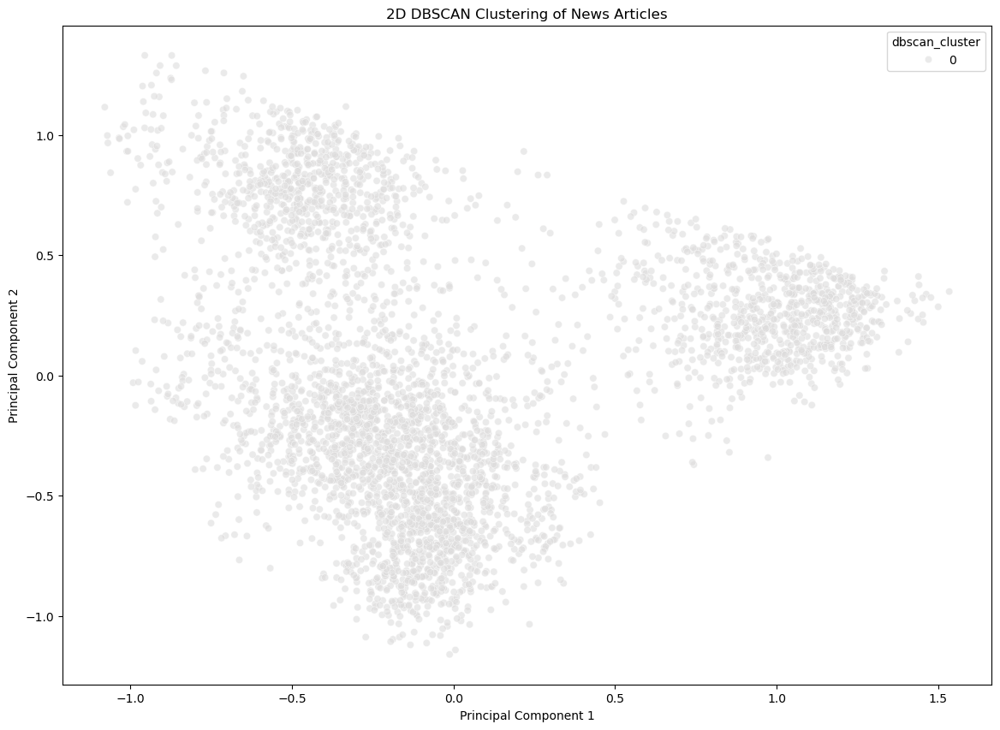

...

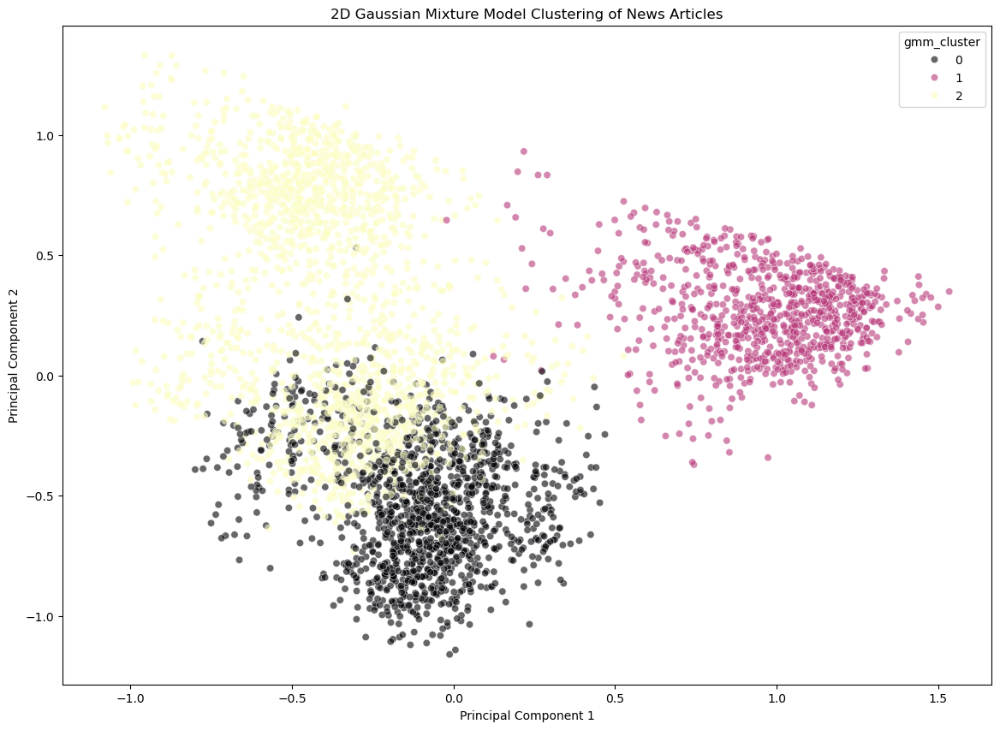

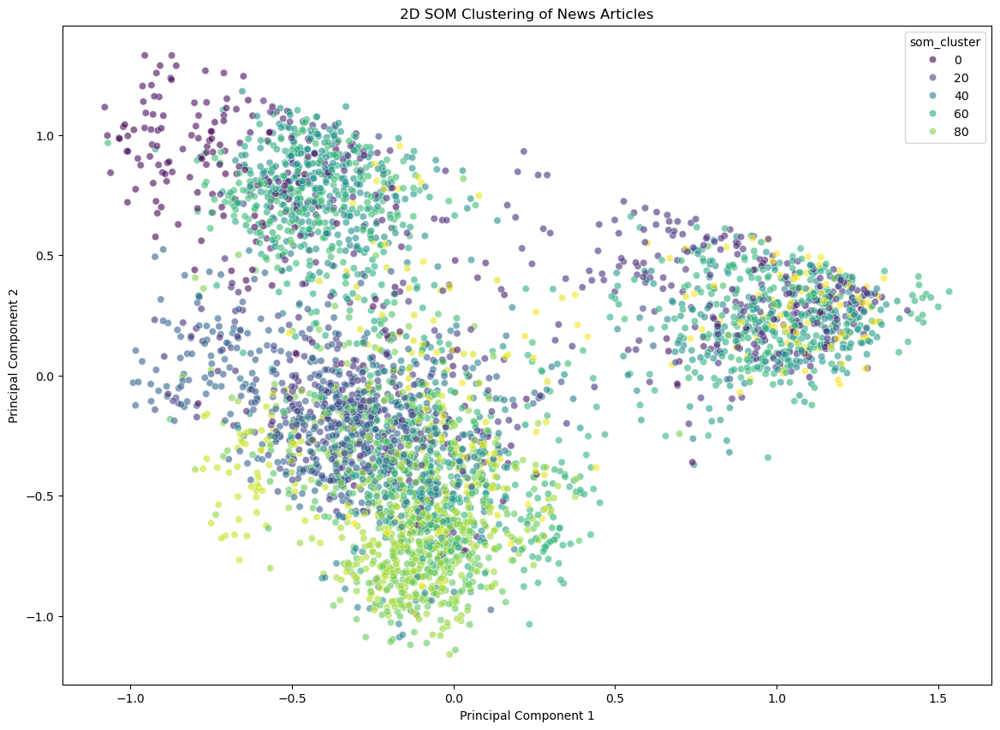

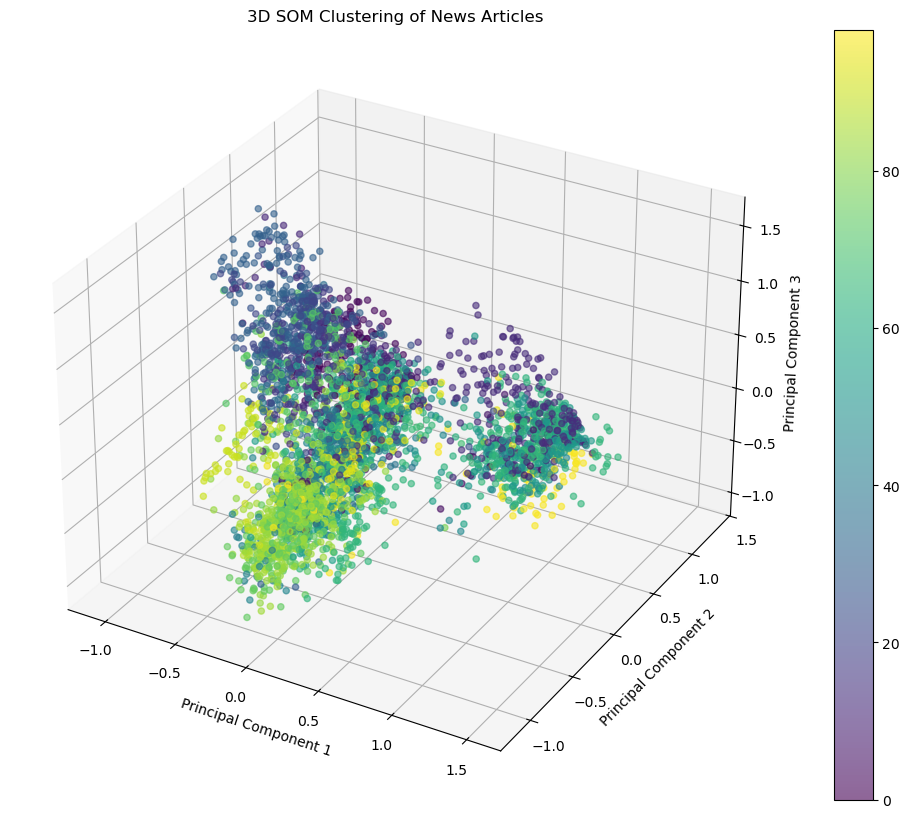

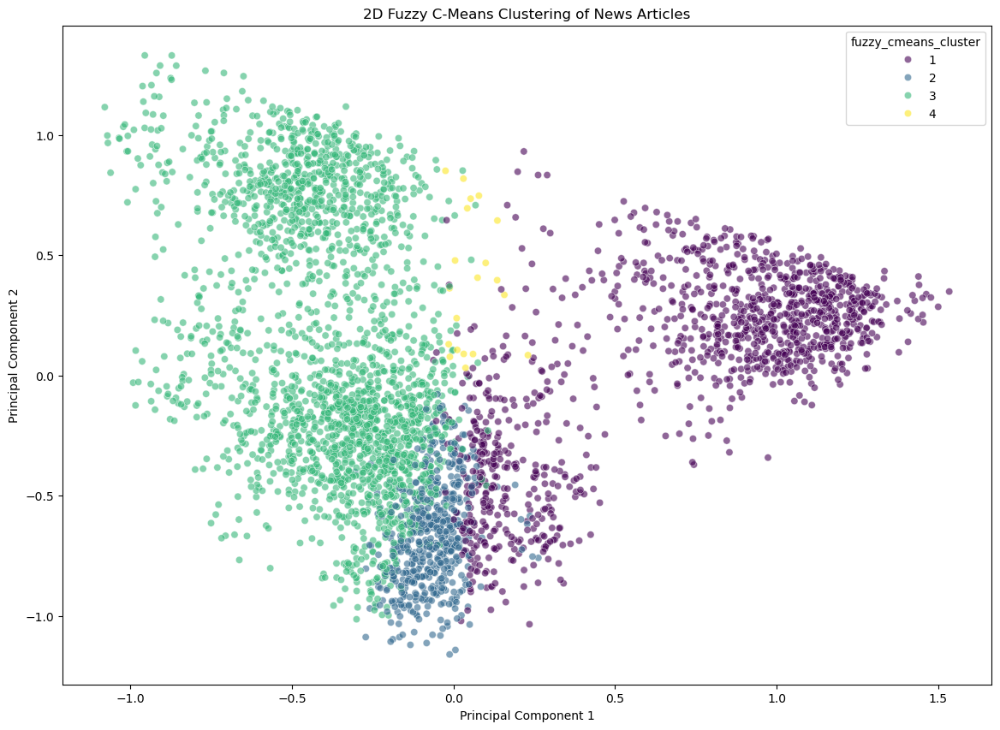

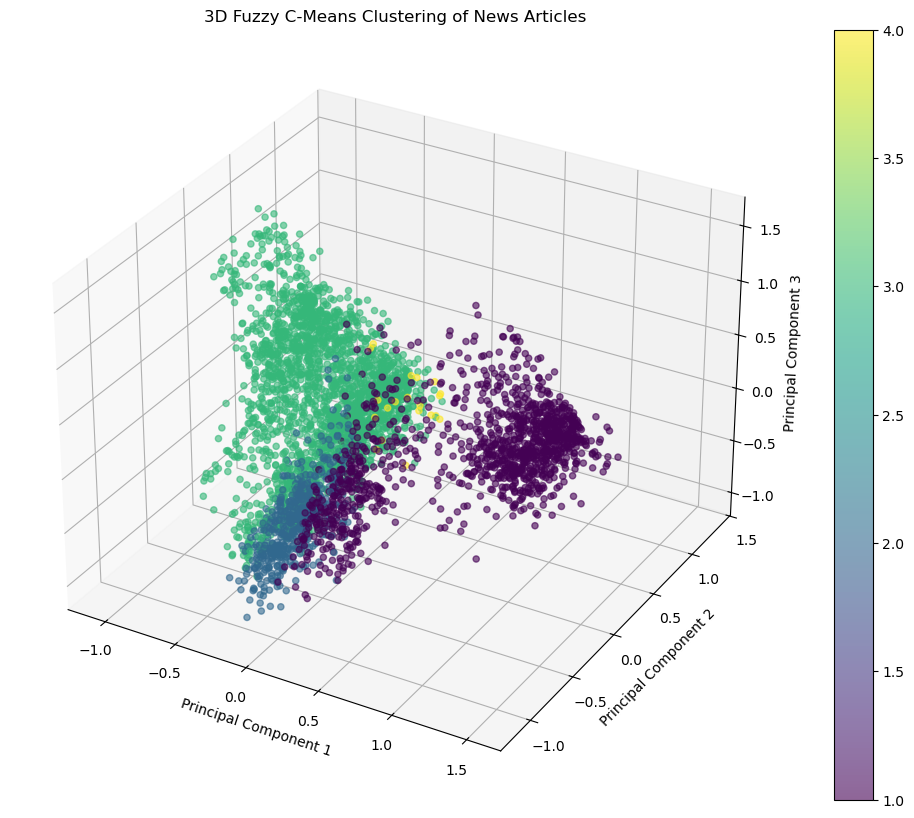

In [ ]:

# 2D K-means plot
plt.figure(figsize=(14, 10))
sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=df['kmeans_cluster'], palette='viridis', alpha=0.6)
plt.title('2D K-means Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

# 3D K-means plot
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(reduced_data[:, 0], reduced_data[:, 1], reduced_data[:, 2], c=df['kmeans_cluster'], cmap='viridis', alpha=0.6)
plt.title('3D K-means Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.colorbar(sc)
plt.show()

# 2D Hierarchical plot
plt.figure(figsize=(14, 10))
sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=df['hierarchical_cluster'], palette='viridis', alpha=0.6)
plt.title('2D Hierarchical Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

# 3D Hierarchical plot
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(reduced_data[:, 0], reduced_data[:, 1], reduced_data[:, 2], c=df['hierarchical_cluster'], cmap='plasma', alpha=0.6)
plt.title('3D Hierarchical Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.colorbar(sc)
plt.show()

# 2D DBSCAN plot
plt.figure(figsize=(14, 10))
sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=df['dbscan_cluster'], palette='coolwarm', alpha=0.6)
plt.title('2D DBSCAN Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

# 3D DBSCAN plot
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(reduced_data[:, 0], reduced_data[:, 1], reduced_data[:, 2], c=df['dbscan_cluster'], cmap='coolwarm', alpha=0.6)
plt.title('3D DBSCAN Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.colorbar(sc)
plt.show()

# 2D GMM plot
plt.figure(figsize=(14, 10))
sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=df['gmm_cluster'], palette='magma', alpha=0.6)
plt.title('2D Gaussian Mixture Model Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()



# 2D SOM plot
plt.figure(figsize=(14, 10))
sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=df['som_cluster'], palette='viridis', alpha=0.6)
plt.title('2D SOM Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

# 3D SOM plot
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(reduced_data[:, 0], reduced_data[:, 1], reduced_data[:, 2], c=df['som_cluster'], cmap='viridis', alpha=0.6)
plt.title('3D SOM Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.colorbar(sc)
plt.show()

# 2D Fuzzy C-Means plot
plt.figure(figsize=(14, 10))
sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=df['fuzzy_cmeans_cluster'], palette='viridis', alpha=0.6)
plt.title('2D Fuzzy C-Means Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

# 3D Fuzzy C-Means plot
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(reduced_data[:, 0], reduced_data[:, 1], reduced_data[:, 2], c=df['fuzzy_cmeans_cluster'], cmap='viridis', alpha=0.6)
plt.title('3D Fuzzy C-Means Clustering of News Articles')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.colorbar(sc)
plt.show()
